## SLAM-Particle Filter for Qubits under Dephasing

The purpose of this workbook is to apply *qslam* to infer a uniform dephasing noise field from single-qubit Ramsey measurements performed on a grid of qubits.

First, we import the relevant packages

In [1]:
import sys
sys.path.append('../')
from qslam.preamble import *

#### Physical Device 
We assume that a physical device consists of a fixed grid of qubits. The location of a qubit on the grid is known and described in terms of grid-coordinates. For example, we specify a square grid of qubits below: 

In [2]:
x_grid=20
y_grid=20
devicegrid = [x_grid, y_grid] # only square grids for now
# functions to be updated later for rectangular grids / graph representation in 2D

#### True Dephasing

We now create a  dephasing noise field over this grid. In simulation, at each grid point, we define the derivative of the phase noise field that needs to be inferred using single qubit measurements:

In [3]:
# --------------
# Examples of deterministic maps
# --------------

uniform_map = np.ones((x_grid, y_grid))*np.pi*0.5
leftgradient_map = np.ones((x_grid, y_grid))*np.linspace(0, np.pi, x_grid)
cornergradient_map  = 0.5*(leftgradient_map + leftgradient_map.T)

radials = np.zeros((x_grid, y_grid))
for idx in xrange(int(x_grid*0.5)):
    for idy in xrange(int(y_grid*0.5)):
        radials[idx, idy]= (idy**2 + idx**2)*np.pi*0.25/ 6**2

radialmap = radials + radials[::-1, ::-1] + radials[:, ::-1] + radials[::-1, :] 

# --------------
# Initiate a true map
# --------------
truth = TrueMap(m_vals=radialmap)

#### Control Positions and Scan Ranges

Next, we want to set up a measurement protocol. In code, this means we specify the sequence in which qubits are made available for a sensing measurement. We call these 'controls' as one can imagine that the availbility of qubits on the grid is analogous to telling a 'robot' where to go next in a SLAM framework. 

In [4]:
# --------------
# Examples of control sequences for different grid sizes
# -------------- 

gridcontrol3 = [(0, 2, 1.5)]*1 + [(2, 0, 1.5)]*1
gridcontrol20 = [(2, 2, 2.)]*3   + [(6, 18, 0.)]*5 + [(18, 6, 2.)]*5 + [(15, 15, 2.)]*1 + [(12, 12, 4.)]*1

# --------------
# Initiate a true control
# -------------- 

controls = gridcontrol20*1

print("Control sequence will take measurements at the following locations:")
print [(idx[0], idx[1]) for idx in controls]

Control sequence will take measurements at the following locations:
[(2, 2), (2, 2), (2, 2), (6, 18), (6, 18), (6, 18), (6, 18), (6, 18), (18, 6), (18, 6), (18, 6), (18, 6), (18, 6), (15, 15), (12, 12)]


Why is there a third parameter in each control? The third parameter refers to how measurement information at a location (x,y) is "blurred" over the neighbours of (x,y). This is called a 'scan range' - a correlation length that spreads information under the assumption that dephasing noise fields are continuously varying in space. For the controls above, the scan ranges are:

In [5]:
print("Control sequence will blurr information to nearest neighbours within a correlation length:")
print [(idx[2]) for idx in controls]

Control sequence will blurr information to nearest neighbours within a correlation length:
[2.0, 2.0, 2.0, 0.0, 0.0, 0.0, 0.0, 0.0, 2.0, 2.0, 2.0, 2.0, 2.0, 2.0, 4.0]


As more measurements are taken, a histogram of qubit measurements at each location is the sample-estimate of the true Born probability of observing a '1' on the qubit, and hence can be used to infer the dephasing noise field. However, we want to minimise the amount of measurements taken, and 'blurring' a data point over its neighbours allows us to use 'quasi-measurement' information to infer true dephasing noise. 

#### Initiating SLAM using a Particle Filter

The true state being estimated is the qubit state under a dephasing noise field, namely, we wish to estimate and track the derivative of the phase noise field and compare it to the true map specified for the device.

qslam has been implemented as a particle filter to accomodate non-linear system descriptions and to accomodate the quasi-measurement (blurring) feature. A particle filter requires the user to specify the total number of particles used to approximate the probability distribution (posterior) describing the true state of the system. Changing the number of particles in a particle filter improves the variance on the true state estimates - for a test run with uniform dephasing, it's sufficient to get true state estimates with only 1 particle.

In [6]:
particle_num=20

The SLAM framework is initiated for a given device as follows:

In [7]:
slamize = ParticleFilter(num_p=particle_num, localgridcoords_=devicegrid)

The code above sets up a particle filter SLAM framework. 

In this framework:

1. Phyiscal Device :: *devicegrid* :: defined by grid coordinates; a qubit sits on each grid node. Currently only square grids considered. 
2. Sensing Qubit :: *globalbot* :: defined as a **robot**, with a **map** and **scanner**. Robot positions are given as grid coordinates; availability of a sensing qubit is modelled as the movement of a robot from one location to another, specified by *controls* (perfectly). Scanner makes a single physical measurement at a location; then uses the physical measurement to generate a number of quasi-measurements over its nearest neighbours. Physical and quasi measurements are passed on the particle filter. (We assumes that only one sensing qubit is available on the grid at any given time.) The map of the Sensing Qubit is updated using only physical measurements (no quasi-msmts are used).  
3. Particle Filter :: *single particle* :: defined as a **robot**, with a **map**, and a one-step-ahead **predictor**. Robot (particle) position is inherited from the Sensing Qubit. Particle map and predictor are used to make one-step ahead predictions at the current location and its nearest neighbours. This predicted region is compared with physical msmt and quasi measurement data from the Sensing Qubit. The residuals over the entire region are used to calculate a weight (likelihood) for the robot (particle). 
4. Particle Filter :: *posterior map* :: returns posterior map. State information is combined across particles - such that a highly likely particles contribute more information to the overall posterior. 

The above framework is completely general. Note that initiation only requires the user to specify the number of particles.

#### Running qslam

We run qslam using the *qslam_run* method, for a simulated dephasing noise map and a given control path:

In [8]:
# %%timeit
# with suppress_stdout():

slamize.qslam_run(truth, controls) # predictions function can't handle rectangular grids


I'm begining qslam_run

I've got a true environment that looks like this:
[[ 0.          0.02181662  0.08726646  0.19634954  0.34906585  0.54541539
   0.78539816  1.06901417  1.3962634   1.76714587  1.76714587  1.3962634
   1.06901417  0.78539816  0.54541539  0.34906585  0.19634954  0.08726646
   0.02181662  0.        ]
 [ 0.02181662  0.04363323  0.10908308  0.21816616  0.37088247  0.56723201
   0.80721478  1.09083078  1.41808002  1.78896248  1.78896248  1.41808002
   1.09083078  0.80721478  0.56723201  0.37088247  0.21816616  0.10908308
   0.04363323  0.02181662]
 [ 0.08726646  0.10908308  0.17453293  0.283616    0.43633231  0.63268185
   0.87266463  1.15628063  1.48352986  1.85441233  1.85441233  1.48352986
   1.15628063  0.87266463  0.63268185  0.43633231  0.283616    0.17453293
   0.10908308  0.08726646]
 [ 0.19634954  0.21816616  0.283616    0.39269908  0.54541539  0.74176493
   0.9817477   1.26536371  1.59261294  1.96349541  1.96349541  1.59261294
   1.26536371  0.9817477   0.74

../qslam/sensing.py:149: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  born_est = self.r_questbk[pose_x, pose_y]
../qslam/particle.py:107: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  predictions.append(self.r_measure(np.nan_to_num(self.m_vals[pred_x, pred_y])))# this needs to cope for missing data



>>> Guestbook was updated to:
[[ nan  nan   1.  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan
   nan  nan  nan  nan  nan  nan]
 [ nan   1.   1.   0.  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan
   nan  nan  nan  nan  nan  nan]
 [  1.   1.   1.   0.  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan
   nan  nan  nan  nan  nan  nan]
 [ nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan
   nan  nan  nan  nan  nan  nan]
 [ nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan
   nan  nan  nan  nan  nan  nan]
 [ nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan
   nan  nan  nan  nan  nan  nan]
 [ nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan
   nan  nan  nan  nan  nan  nan]
 [ nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan
   nan  nan  nan  nan  nan  nan]
 [ nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan  nan
   nan  nan  nan  nan  nan  nan]
 [ nan  nan  nan  nan  n

../qslam/particle.py:88: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  prob = self.r_questbk[u_x, u_y] # this will be not Nan if the previous loop is completed
../qslam/particle.py:91: VisibleDeprecationWarning: using a non-integer number instead of an integer will result in an error in the future
  self.m_vals[u_x, u_y] = self.get_phase_method(prob) # this will update a nan value to a number


#### Results

The key check for any simulation is that the map of Sensing Qubit (*globalbot*, based on physical measurements) and posterior map of Particle Filter are identical in the limit of infinite measurements and zero quasi-measurement scan range. 

For finite, minimal measurements, quasi-measurement data allows particle filter to infer map faster.
We can calculate the squared error between the true and inferred maps, and re-scale error by the maximum possible value (pi^2)

In [9]:
# Global Bot
sample_born_est = np.asarray([slamize.particles[0].get_phase_method(val) for val in slamize.global_bot.r_questbk.flatten()]).reshape(x_grid,y_grid)
resid_globalbot = (truth.m_vals - sample_born_est)**2 / np.pi**2

# Particle Map
posterior=0.
for idx in range(particle_num):
    posterior += (1./particle_num)*slamize.particles[idx].m_vals
resid_posterior = (truth.m_vals - posterior)**2  / np.pi**2

Below, we plot the residual squared error maps (not RMS) for (a) globalbot and (b) posterior map from the particle filter, with respect to the true maps. Both should converge to zero error for infinite measurements, but the rate of convergence should be faster for (b). 

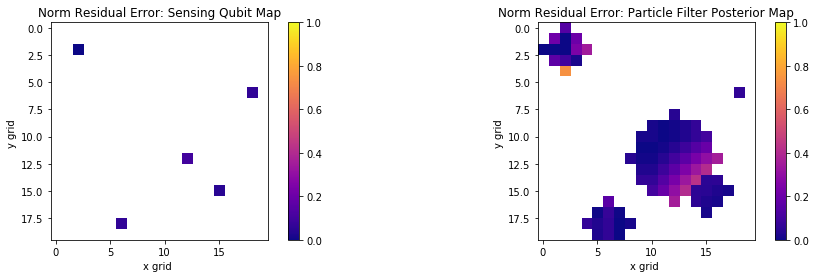

In [10]:
plt.figure(figsize=(16,4))

plt.subplot(1,2,1)
plt.title('Norm Residual Error: Sensing Qubit Map')
plt.imshow(resid_globalbot, cmap='plasma', vmin=0, vmax=1.)
plt.colorbar()
plt.xlabel('x grid ')
plt.ylabel('y grid ')

plt.subplot(1,2,2)
plt.title('Norm Residual Error: Particle Filter Posterior Map')
plt.imshow(resid_posterior, cmap='plasma', vmin=0, vmax=1.)
plt.colorbar()
plt.xlabel('x grid ')
plt.ylabel('y grid ')

plt.show()


The actual maps of the derivative of the dephasing field corresponding to the plots above are:

All values lie in [0, pi] radians; representing derivative of phase noise field at qubit locations.


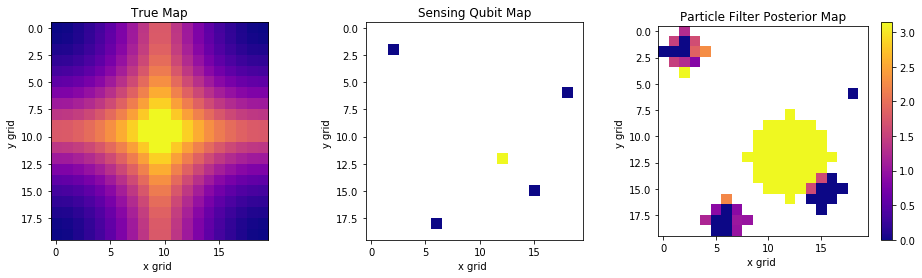

In [11]:
print('All values lie in [0, pi] radians; representing derivative of phase noise field at qubit locations.')

fig = plt.figure(figsize=(16,4))

plt.subplot(1,3,1)
plt.title('True Map')
ax1 = plt.imshow(truth.m_vals, cmap='plasma', vmin=0, vmax=np.pi)
plt.xlabel('x grid ')
plt.ylabel('y grid ')

plt.subplot(1,3,2)
plt.title('Sensing Qubit Map')
plt.imshow(sample_born_est, cmap='plasma', vmin=0, vmax=np.pi)

plt.xlabel('x grid ')
plt.ylabel('y grid ')

plt.subplot(1,3,3)
plt.title('Particle Filter Posterior Map')
plt.imshow(posterior, cmap='plasma', vmin=0, vmax=np.pi)

plt.xlabel('x grid ')
plt.ylabel('y grid ')

plt.colorbar(ax1)
plt.show()

### DISCUSSION

#### Objectives:

G1: Infer the qubit state under spatial dephasing using single shot measurements on a grid of qubits

G2: Find the most optimal control sequence of measurements to create noise map

G3: Find sharp boundaries and edges on this noise field 

For G1:, we want to do better than taking infinite measurements at every location.

For G2:, we want to do better than taking some finite number measurements at random points on the grid.

For G3:, we want a way to learn how regions on the grid are correlated.

#### Key Challenge:

There is no equivalent of a classical measurement protocol that allows us to scan the environment.

#### Current qslam:

We smear a single shot physical measurement information over the nearest neighbours of a physical qubit. The size of the neighbourhood  is currently a controlled parameter. 

#### Target Properties of qslam and key technical barriers: 

T1: In the infinite measurement limit, the physical map based on estimates of the Born probability should be the same as the maps inferred from the inference procedure. 

With T1.,  the technical barrier is that it's very likely that inference procedure will introduce a systemic bias in inferred map over long measurement records. In particular, an averaging type effect allows us to minimise this bias. However, averaging over a region makes it impossible to detect edges and boundaries. 

T2: The size of the neighbourhood - parameterised by scan-range - should change during the inference procedure to reflect change in (a) smoothly varying features depending on the location on the grid and (b) more physical msmt info.

With T2., the challenge is that particles (at present) all move to the desire control with the same location, and scan_range. This means that scan_range can't change to reflect increase measurement info. Suppose we randomly generated scan_range values, and let the likelihood pick out the most likely particles (scan_ranges). Then all particles have the same controls, and we're assuming that the same scan_range applies at different regions. This is obviously unphysical. Hence, we require a collection of particles to be assoicated with a location label, e.g. each new grid point visited, and within that collection, to have a randomisation of scan_ranges.

T3: The smearing of physical to quasi-msmt information needs to allow for re-observation of existing neighbourhoods in a way that updates the scan_ranges for each collection of particles. This is because quasi-measurement data is not real, and re-observation of neighbourhoods will help correct scan-range learning based on some smeared physical msmt information.




#### Deterministic 'true noise' field:

Assumption 1. Physical noise fields are continuously varying in space (no sharp edges or spikes). 

*** Using spatial correlations to define 'quasi measurements' ***

In the current SLAM, we use a spatial correlation parameter (as a control) to blurr a physical measurement on a single qubit over a small region of its nearest neighbouring qubits.  We average out information over some nearest neighbour region - if the spatial correlations are smooth and slowly varying wrt to the grid resolution, then appropriate learning of the spatial control parameter will yield in a good noise map with fewer measurements.

One idea would be to let the scan-range move from being a control, to being a random parameter that particles are associated with upon resampling, and the bayesian likelihood chooses the particle that has the most likely scan range. However, this method would work if we had an actual physical measurement for the all neighbours. however each particle receives quasi measurement data; which is not real data but an assumption about how qubits are spatial correlated.

A second idea would be to make the scan range parameter a part of the state (as it is already) but the allow some sort of state update. However, in this scenario, we make the erroneous assumption that correlation lengths are the same every where in space, or rather, an average correlation length is enough to do inference anywhere in the grid.


*** Consider a single msmt ***


What I want to do is that every location, each particle has a random uniform distirbution of correlation lengths. then, we get a physical measurement 

>> At present, I am saying, that if a field has a value X at pos a, then any point in a circle at pos a with radius r will have a value f(X, r). (smear it, for example, using a Gaussian kernel). 

>> However, a stronger statement about continuity invokes the covariance stationarity of a random process. We consider all circles centered at pos a with radius 1, 2, ..... Then, the measurement at pos a gives us correlation information at all radii. This could be exactly the same as having a spatial AR process and learning the AR coefficients. 


*** Consider a two msmts with some overlapping neighbourhood ***

- currently, the map update is just the sample born probability. In this approach, physical and quasi measurements are treated equally; and the properties of the quasi measurement action are determined by the controls. Even if the scan ranges are randomised, in the absence of real data and knowledge of the scan range, we will be unable to distibugishh a noisy scan estimate from a good one, and the map will be corrupted by bad systematically introduced errors. 

What you want is a way to randomly extend or contract the scan range for each particle and to conduct a predictive measurement. the resampling technique will automatically choose the particles with the best scan-range. Hence, while there is no uncertainty of the robot position, the true state varuiable being implemented / estimated is the spatial correlation length for quasi-measurements at each location. 

This would work if we had real data on all the neighbours - but we don't. So what we could do, is (a) update correlations matrix for all possible pairs or (b) reverse engineer the measurement procedure.

(a) pairwise correlations estimation: for all possible pairs of physical measurements, update the correlations  between these map features. this is similar to an AR process

(b) take the existing map value in a neighbourhood, compute the prediction on the physical qubit. use the residual / likelihood value to update the map. if all qubits are in the neighbourhood, then this approach is trying to do the same thing as (a)

For any approach, the overlapping neighbourhood (or the whole pairwise correlation space), the following things should be tested:

- What happens when 2 or more neighbourhoods overlap? Is the overlap region better than the inference procedure than if only or the other neighbourhood was considered? 
- What happenens if many regions overlap? Does that give a better or a worse estimate?
- What is the structure to learn or posit pairwise correlations and / or make quasi measurements (e.g. kernel shape, kernel hyper-parameters)? How do we learn or tune them using data?

At present, it is not clear if the benefits of simultaneous mapping and localisation benefits that accrue from re-observing map features - are being utilised. This is a key question that needs to be explored with more care.


*** Consider infinite msmts ***

In the case of infinite msmts, inference is garanteed to work as we have access to the Born rule. Here, in the infinite msmt limit, the SLAM framework converges with our ideal situation - all map features are correlated with all other map features and the qubit state (robot pose)

For finite msmts, we need reduce the relative weight of quasi msmts and / or shrink scan range to zero to accomodate the accumulation of real data. In fact, the treatment of re-observation in standard SLAM (such that all features become correlated over time) is associated with the need for quasi-measurements to model a classical "laser scan" in our application. 

Hence, is there a combination of physical and quasi msmts that are optimal for inference? As measurements increase, the scan ranges can be reduced such that quasi-measurements have a lesser impact on the inference procedure compared to actual measurements. How do we find or test for this optimal weight recursively, and when do we stop changing the scan range?


*** Consider the number of particles in a particle filter version of SLAM ***

- How does increasing the number of particles reduce state variance? Where does it flatline?
- Can the assymetry of errors in our application be reduced by increasing the number of particles? (for quasimeasurements, for the case true map is all zeros has more errors than when true noise is all pi (less errors).
- Why does the particle map differentiate significantly from n=3 to n=4 msmts at the same spot (why not n=2)?


*** Extensions (not implemented) ***

 - Every particle in the particle filter should have a randomised scan range, and the weighting procedure should pick out the most relevant scan range based on the likelihood function
 - Change the likelihood function based on second paper
 - Jitter in dephasing noise map ==> model this as imperfect knoweldge of robot position on the grid.
 - Time domain dynamics of map ==> add a temporal AR process to evolve the map at each time step

#### Wide Sense Stationary 'True Noise' Field

Assumption 2. Physical noise is represented by wide sense stationary process # not yet 


2. Is the likelihood function correct?
No, needs to be swapped out for the QKF likelihood function.

3. What is the threshold to stop the algorithm?
None, just the number of controls 